# El Nino

This notebook is really a continuation of the [shallow_water notebook](https://github.com/jduffield65/ClimateModel/blob/c17478a96655b9f34c6290754ed4a075bbae501f/shallow_water.ipynb) but the default parameters used, as given in the cell below, are different. 

The goal of this notebook is to follow chapter 22.10 of AOFD to model the oscillation of the thermocline thickness which occurs during the El Nino in the pacific ocean. So we are modelling the ocean not the atmosphere.

We can model this by adjusting the shallow water equations ($(5)$ in [```shallow_water.ipynb```](https://github.com/jduffield65/ClimateModel/blob/c17478a96655b9f34c6290754ed4a075bbae501f/shallow_water.ipynb)) to include damping and an interaction with the atmosphere. The damping is included just by adding the terms $-ru$ and $-rv$ to the right hand side of the equations, where $r$ is the damping coefficient with units $s^{-1}$. The interaction with the atmosphere can be included though the wind kinematic stress terms, $\frac{\partial \pmb{\tau}}{\partial z}$ (Chapter 19.1 of AOFD). At the equator, the wind is easterly so we just include wind stress in the $u$ equation. We approximate $\frac{\partial \tau^x}{z}$ as $\frac{\tau^x}{h_{mean}}$ So the new shallow water momentum equations become:

\begin{equation}
\frac{du}{dt} - fv =  -g\frac{\partial h_s}{\partial x} - ru + \frac{\tau^x}{h_{mean}} \\
\frac{dv}{dt} + fu =  -g\frac{\partial h_s}{\partial y} - rv
\label{eq: 1}\tag{1}
\end{equation}

In an El Nino event, the interaction between the ocean and atmosphere takes place via the Bjerknes feedback: a positive anomaly (deeper thermocline) propogates eastward as a Kelvin wave, thickening the thermocline, warming the sea surface, generating anomalous eastward winds. This can be parameterised through (Equation 22.105 in AOFD):

\begin{equation}
\frac{\tau^x}{h_{mean}} = \gamma (\overline{h}_{east} - \overline{h}_{west}) - \frac{\tau^x_0}{h_{mean}}
\label{eq: 2}\tag{2}
\end{equation}

where $\tau^x_0$ (positive) represents the westward trade winds and $\overline{h}_{east}$ and $\overline{h}_{west}$ are the averaged thermocline thicknesses in the eastern and western boundaries. $\gamma$ is a coupling coefficient, the value of which, the simulation is quite sensitive to. From this, you can see that the deeper the thermocline in the east, the more eastward (positive) the wind.

We also are using the reduced gravity equations so $g$ is not $g_{Earth} = 9.81 ms^{-2}$ but much smaller ($g = g_{Earth}(\rho_{deep} - \rho_{thermocline}) / \rho_{thermocline}$) because it is a measure of the density difference between the upper and lower ocean.

We inititialise the El Nino simulation with the fluid at rest, so from $(1)$, this means that:

\begin{equation}
g\frac{\partial h_s}{\partial x} = \frac{\tau^x}{h_{mean}} \\
\frac{\partial h_s}{\partial y} = 0
\label{eq: 3}\tag{3}
\end{equation}

with $\frac{\tau^x}{h_{mean}} =  - \frac{\tau^x_0}{h_{mean}}$ initially as the feedback has not started yet. So the equatorial easterly wind in the atmosphere causes the [initial thermocline thickness](https://github.com/jduffield65/ClimateModel/blob/c17478a96655b9f34c6290754ed4a075bbae501f/Model/dynamics/shallow_water.py#L206-L216) (fluid depth, $h$) to deepen linearly towards the west. We also set $h$ to fall off exponentially away from the equator.

In [1]:
from Model.dynamics.shallow_water import ShallowWater
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from Model.constants import g as g_earth
from Model.constants import R_earth, Omega
from tqdm import tqdm # loading bar

# Default values to run simulation
n_days0 = 800
mean_h_surface0 = 9750 # height of basic level in m.
f_00 = 0  # Coriolis parameter (s-1), 0 at equator
beta0 = 2 * Omega / R_earth  # Meridional gradient of f (s-1m-1)
boundary_type0 = {'x': 'walls', 'y': 'walls'} # continents provide walls to ocean in x direction.
orography_info0 = None
numerical_solver0 = 'richtmyer'
nPlotFrames0 = 350
save_every0 = 24*60**2 # only save data every day to stop memory issues
g0 = 0.05 # reduced gravitational constant, much smaller.
r0 = 1 / (16 * 30 * 24 * 60 ** 2)  # damping time scale of 16 months

h_mean = 100
c = np.sqrt(g0 * h_mean) # speed of kelvin wave
L_def0 = np.sqrt(c / beta0)
dx0 = L_def0 / 5
dy0 = dx0
nx0 = int(round(30 * L_def0 / dx0))
ny0 = int(round(15 * L_def0 / dy0))
courant_target = 0.01
dt0 = courant_target * dx0 / c
h_perturb = h_mean / 100 # size of perturbation to surface height at the equator on either boundary
initial_info0 = {'type': 'el_nino', 'max_h_surface': h_mean+h_perturb, 'min_h_surface': h_mean-h_perturb,
                'y_std': L_def0, 'add_noise': False}


def run_simulation(initial_info=initial_info0, n_days = n_days0, nx=nx0, ny=ny0, dt=dt0, dx=dx0, dy=dy0, f_0=f_00, beta=beta0, 
                   orography_info=orography_info0, boundary_type = boundary_type0, 
                   numerical_solver=numerical_solver0, nPlotFrames=nPlotFrames0, save_every=save_every0, g=g0, r=r0):
    """Function to run simulation producing animation of surface height and vorticity evolution"""
    
    shallow_world = ShallowWater(nx, ny, dx, dy, dt, f_0, beta, initial_info=initial_info,
                             numerical_solver=numerical_solver, boundary_type=boundary_type,
                             orography_info=orography_info, g=g, r=r)
    
    forecast_length = n_days * 24.0 * 60**2  # Forecast length (s)
    nt = int(np.fix(forecast_length / dt) + 1)  # Number of timesteps
    
    t = 0
    data_dict = {'t': [t], 'h': [shallow_world.h], 'u': [shallow_world.u], 'v': [shallow_world.v]}
    for n in tqdm(range(0, nt)):
        t, data_dict = shallow_world.time_step(t, data_dict, save_every)
        
    anim = shallow_world.plot_animate(data_dict['t'], data_dict['h'], data_dict['u'], data_dict['v'],
                                      nPlotFrames=nPlotFrames, fract_frames_at_start=0)
    plt.close()
    return anim, data_dict, shallow_world

/Users/joshduffield/Documents/ObjectOrientatedPython/PyCharmTest/venv/lib/python3.8/site-packages/sympl/_core/dataarray.py:6: FutureWarning: xarray subclass DataArray should explicitly define __slots__
  class DataArray(xr.DataArray):


## Unforced evolution
We first simulate the unforced case. This is where $\frac{\tau^x}{h_{mean}} =  - \frac{\tau^x_0}{h_{mean}}$ initially but $\frac{\tau^x}{h_{mean}} =  0$ for $t>0$. i.e. when the simulation starts, the easterly wind is switched off and there is no feedback between the atmosphere and ocean. A Kelvin wave then propogates eastward. When it collides with the eastern boundary, it generates a poleward propagating coastal Kelvin wave and a tongue of deeper water spreading out from the east (seen clearly at 64 days). 

The disturbance is damped by the production of the coastal waves but it propogates back west as a Rossby wave, and then back east again as a Kelvin wave. This pattern continues forming oscillating El Nino and La Nina events. 

In [2]:
# Slow!!
anim, data_dict_en1, en1_world = run_simulation()
HTML(anim.to_jshtml())

100%|██████████| 247259/247259 [13:29<00:00, 305.26it/s]
Animation size has reached 20999917 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### Plotting Oscillation
It is easier to see the oscillation if we plot the average thermocline thickness at the east and west boundaries as a function of time. We can do this using the function [```el_nino_plot```](https://github.com/jduffield65/ClimateModel/blob/c17478a96655b9f34c6290754ed4a075bbae501f/Model/dynamics/shallow_water.py#L608-L651). This computes the thermocline thickness at the east and west boundaries by averaging betwen the boundary and a distance ```x_average_width``` away in the x direction and between $\pm$ ```y_average_width/2``` of the equator in the y direction.

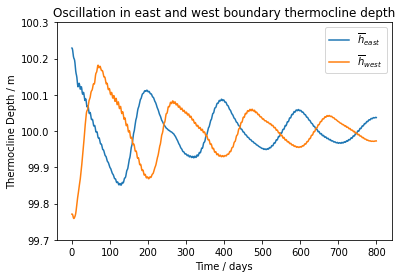

In [3]:
fig_en1 = ShallowWater.el_nino_plot(np.array(data_dict_en1['t']), np.array(data_dict_en1['h']), en1_world.X, en1_world.Y,
                                x_average_width=8*L_def0, y_average_width=8*L_def0)